<a href="https://colab.research.google.com/github/arunmalik1/PlantLeaf_Classification/blob/main/PlantLeaf_Classification_TransferModels.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This project is binary classification project using plant images. The idea is to be able to identify diseased vs healthy plants. There are 11 different plants and the entire dataet is divded into 22 categories. 

The dataset is from Kaggle: 
This is a collection of about 4503 images of which contains 2278 images of healthy leaf and 2225 images of the diseased leaf. Twelve plants named as Mango, Arjun, Alstonia Scholaris, Guava, Bael, Jamun, Jatropha, Pongamia Pinnata, Basil, Pomegranate, Lemon, and Chinar have been selected. Images are split between training, test, validating and prediction datasets for model training and testing purposes.



#Import Packages

In [1]:
#install and upgrade packages 

#need pydicom for images
!pip install pydicom --quiet

#install opendatasets to get the data from Kaggle
!pip install opendatasets --upgrade --quiet

#installing keras tuner 
!pip install keras-tuner --quiet
!pip install -q -U keras-tuner --quiet
!pip install git+https://github.com/keras-team/keras-preprocessing.git --quiet
!pip install --upgrade transformers --quiet
!pip install --upgrade datasets --quiet
!pip install -Uqq fastbook --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.6/169.6 KB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 31.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 52.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.3/190.3 KB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 92.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 462.8/462.8 KB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.0/213.0 KB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.0/132.0 KB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 KB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 52.5 MB/s eta 0:00:

In [2]:
#import packages 
import pandas as pd
import numpy as np
import scipy
from fastbook import *
import cv2


#import plot 
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import Image, display
%matplotlib inline
from PIL import Image
import PIL.Image
import seaborn as sns
import plotly.express as px

#create reports
from tabulate import tabulate
import os
import sklearn.metrics as metrics
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics._plot.confusion_matrix import confusion_matrix
from sklearn.metrics import accuracy_score, classification_report

#import keras and tenserflow and pydicom
import keras
import pydicom
import keras_tuner as kt
from keras import layers
from kerastuner import RandomSearch
from keras.utils import to_categorical
from keras.callbacks import learning_rate_schedule
from kerastuner.engine.hyperparameters import HyperParameters


#import tenserflow functions
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dropout
from tensorflow.keras.regularizers import L1, L2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Dense # creates densely connected layer object
from tensorflow.keras.layers import Flatten # takes 2D input and turns into 1D array
from tensorflow.keras.layers import Conv2D # convolution layer
from tensorflow.keras.layers import MaxPooling2D # max pooling layer
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Activation, Flatten, Dropout, BatchNormalization

<ipython-input-2-00deaf1bf9c4>:33: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import RandomSearch


In [3]:
#get the data from google drive
from google.colab import drive
drive.mount('/gdrive', force_remount=True)

Mounted at /gdrive


#Import Data

In [3]:
#load the train set
train_ds = keras.utils.image_dataset_from_directory(
    directory='/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/train',
    labels = 'inferred',
    label_mode = 'categorical',
    image_size = (256,256),
    batch_size = 32,
    )

Found 4274 files belonging to 22 classes.


In [4]:
#load the test set
test_ds = keras.utils.image_dataset_from_directory(
    directory='/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/test',
    labels = 'inferred',
    label_mode = 'categorical',
    image_size = (256,256)
    )

Found 110 files belonging to 22 classes.


In [5]:
#load the validation set
validation_ds = keras.utils.image_dataset_from_directory(
    directory='/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/valid',
    labels = 'inferred',
    label_mode = 'categorical',
    image_size = (256,256)
    )

Found 110 files belonging to 22 classes.


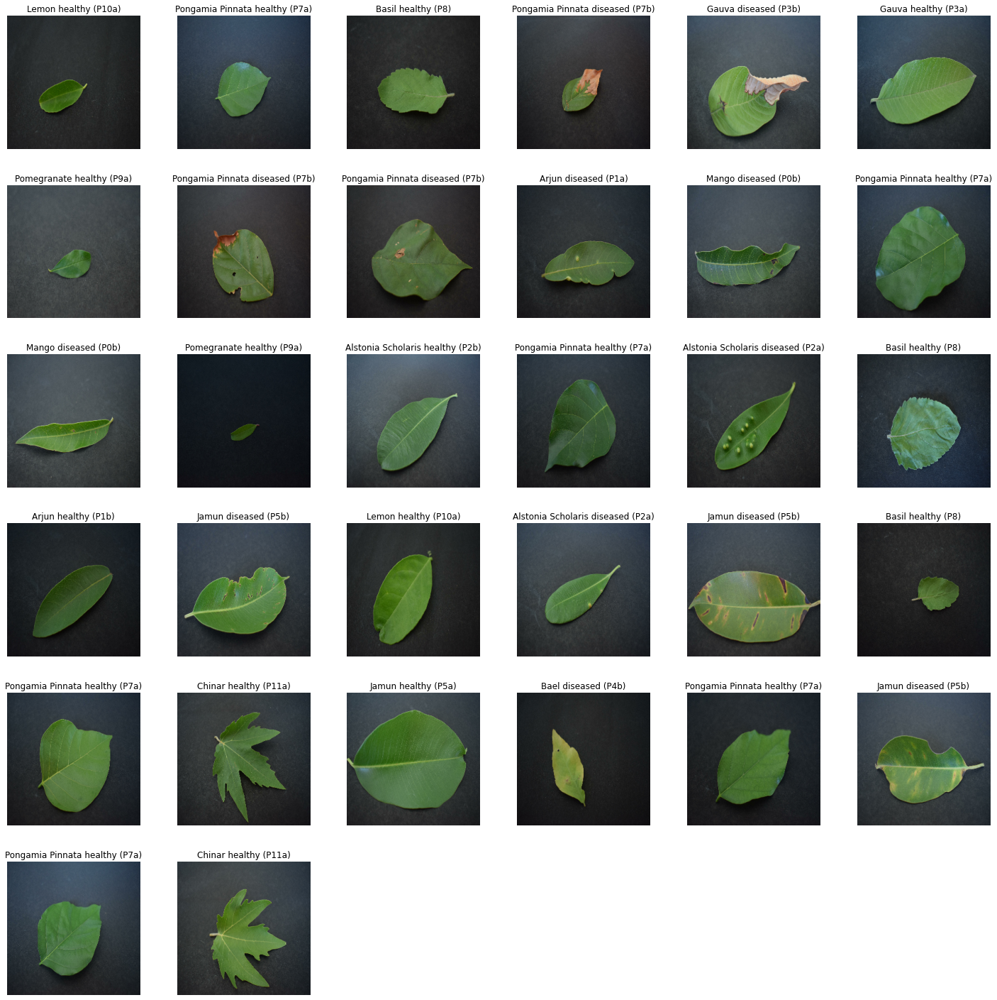

In [6]:
#take a look at some of the images in the train set.
class_names = train_ds.class_names

### To visualize the images
plt.figure(figsize=(20, 20))
for images, labels in train_ds.take(1):
  for i in range(32):
    ax = plt.subplot(6, 6, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[np.argmax(labels[i])])
    plt.axis("off")

# Plotting the images
plt.tight_layout(pad=1)
plt.show()

#Create a base CNN Model

In [82]:
base_model1 = Sequential()
# define 3x3 filter window sizes. Create 32 filters.
base_model1.add(Conv2D(filters=32,
                        kernel_size=(3, 3), strides = (2,2),
                        activation='relu',
                        input_shape=(256, 256, 3)))

#rescale the images 
tf.keras.layers.Rescaling(1./255)
# max pool in 2x2 window

# define 3x3 filter window sizes.
base_model1.add(MaxPooling2D(pool_size=(4, 4)))
base_model1.add(Conv2D(64, (3, 3), activation='relu'))

base_model1.add(MaxPooling2D((2, 2)))
base_model1.add(Conv2D(128, (3, 3), activation='relu'))

base_model1.add(MaxPooling2D((2, 2)))
base_model1.add(Conv2D(256, (3, 3), activation='relu'))

# transition to dense fully-connected part of network
base_model1.add(Flatten())
base_model1.add(Dense(64, activation='relu'))
base_model1.add(Dense(22, activation='softmax'))

In [83]:
base_model1.compile(optimizer='Adam', loss='categorical_crossentropy',  metrics=['accuracy'])

In [84]:
history_cnn = base_model1.fit(train_ds, epochs= 20, validation_data= validation_ds)

Epoch 1/20
134/134 [==============================] - 63s 434ms/step - loss: 3.9446 - accuracy: 0.1928 - val_loss: 2.6505 - val_accuracy: 0.2545
Epoch 2/20
134/134 [==============================] - 60s 424ms/step - loss: 1.9228 - accuracy: 0.4176 - val_loss: 2.2732 - val_accuracy: 0.3545
Epoch 3/20
134/134 [==============================] - 63s 441ms/step - loss: 1.4478 - accuracy: 0.5522 - val_loss: 1.8078 - val_accuracy: 0.4000
Epoch 4/20
134/134 [==============================] - 57s 401ms/step - loss: 1.0859 - accuracy: 0.6563 - val_loss: 1.6731 - val_accuracy: 0.5182
Epoch 5/20
134/134 [==============================] - 61s 433ms/step - loss: 0.8810 - accuracy: 0.7178 - val_loss: 1.4799 - val_accuracy: 0.5182
Epoch 6/20
134/134 [==============================] - 63s 439ms/step - loss: 0.6769 - accuracy: 0.7833 - val_loss: 1.8323 - val_accuracy: 0.5273
Epoch 7/20
134/134 [==============================] - 64s 448ms/step - loss: 0.5496 - accuracy: 0.8180 - val_loss: 1.5949 - val_ac

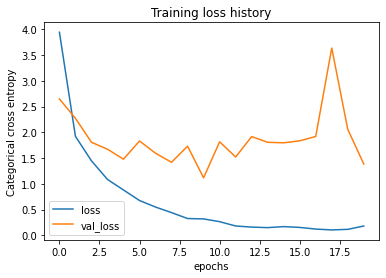

In [85]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

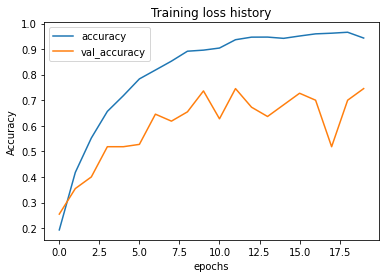

In [86]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [99]:
base_model1.save('Base_model1.h5')

#Building in a simpler base model because of over fitting 

In [91]:
base_model2 = Sequential()
# define 3x3 filter window sizes. Create 32 filters.
base_model2.add(Conv2D(filters=32,
                        kernel_size=(3, 3), strides = (2,2),
                        activation='relu',
                        input_shape=(256, 256, 3)))

#rescale the images 
tf.keras.layers.Rescaling(1./255)

# define 3x3 filter window sizes. Create 32 filters.
base_model2.add(MaxPooling2D((2, 2)))
base_model2.add(Conv2D(32, (3, 3), activation='relu'))

base_model2.add(MaxPooling2D((2, 2)))
base_model2.add(Conv2D(32, (3, 3), activation='relu'))

# transition to dense fully-connected part of network
base_model2.add(Flatten())
base_model2.add(Dense(32, activation='relu'))
base_model2.add(Dense(22, activation='softmax'))

In [92]:
base_model2.compile(optimizer='Adam', loss='categorical_crossentropy',  metrics=['accuracy'])

In [93]:
history_cnn = base_model2.fit(train_ds, epochs= 20, validation_data= validation_ds)

Epoch 1/20
134/134 [==============================] - 58s 399ms/step - loss: 4.3057 - accuracy: 0.2038 - val_loss: 2.6731 - val_accuracy: 0.1636
Epoch 2/20
134/134 [==============================] - 55s 388ms/step - loss: 2.0059 - accuracy: 0.4027 - val_loss: 2.6041 - val_accuracy: 0.2182
Epoch 3/20
134/134 [==============================] - 56s 390ms/step - loss: 1.4052 - accuracy: 0.5767 - val_loss: 2.3205 - val_accuracy: 0.3182
Epoch 4/20
134/134 [==============================] - 57s 401ms/step - loss: 0.9682 - accuracy: 0.6958 - val_loss: 2.6444 - val_accuracy: 0.3364
Epoch 5/20
134/134 [==============================] - 57s 398ms/step - loss: 0.6462 - accuracy: 0.7943 - val_loss: 2.6231 - val_accuracy: 0.3545
Epoch 6/20
134/134 [==============================] - 57s 397ms/step - loss: 0.4310 - accuracy: 0.8636 - val_loss: 2.7070 - val_accuracy: 0.3818
Epoch 7/20
134/134 [==============================] - 56s 394ms/step - loss: 0.3183 - accuracy: 0.9031 - val_loss: 3.1088 - val_ac

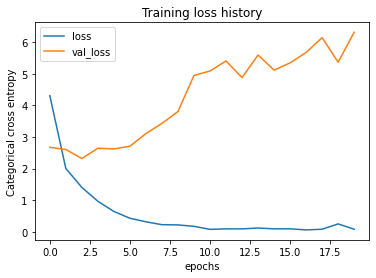

In [94]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

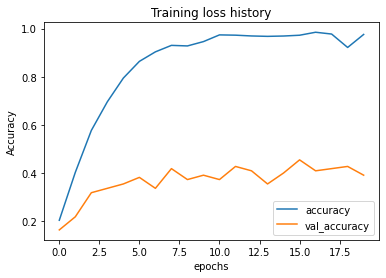

In [95]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [98]:
base_model2.save('BaseSimple.h5')

#Adding more layers to base model for higher accuracy. Using regularizer and dropout techniques to address overfitting.

L1 (Lasso Regression)

In [100]:
reg = L1(1e-5)

In [101]:
L1_model = Sequential()
# define 3x3 filter window sizes. Create 32 filters.
L1_model.add(Conv2D(filters=32,
                        kernel_size=(3, 3), strides = (3,3),
                        activation='relu',
                        input_shape=(256, 256, 3)))

#rescale the images 
tf.keras.layers.Rescaling(1./255)
# max pool in 2x2 window
L1_model.add(BatchNormalization())
L1_model.add(MaxPooling2D(pool_size=(4, 4)))
L1_model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

L1_model.add(BatchNormalization())
L1_model.add(MaxPooling2D((2, 2)))
L1_model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

L1_model.add(BatchNormalization())
L1_model.add(MaxPooling2D((2, 2)))
L1_model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

# transition to dense fully-connected part of network
L1_model.add(Flatten())
L1_model.add(Dense(64, activation='relu'))

#using dropout to create a more robust model
L1_model.add(Dropout(0.5)) 
L1_model.add(Dense(22, activation='softmax'))

In [102]:
opt = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-05)
L1_model.compile(optimizer=opt, loss='categorical_crossentropy',  metrics=['accuracy'])

In [103]:
history_cnn = L1_model.fit(train_ds, epochs= 50, validation_data= validation_ds)

Epoch 1/50
134/134 [==============================] - 66s 452ms/step - loss: 4.3520 - accuracy: 0.0512 - val_loss: 3.3413 - val_accuracy: 0.0818
Epoch 2/50
134/134 [==============================] - 62s 435ms/step - loss: 3.6481 - accuracy: 0.0597 - val_loss: 3.1817 - val_accuracy: 0.0909
Epoch 3/50
134/134 [==============================] - 65s 452ms/step - loss: 3.3959 - accuracy: 0.0805 - val_loss: 3.1470 - val_accuracy: 0.0909
Epoch 4/50
134/134 [==============================] - 61s 424ms/step - loss: 3.1855 - accuracy: 0.0976 - val_loss: 3.1259 - val_accuracy: 0.1091
Epoch 5/50
134/134 [==============================] - 62s 434ms/step - loss: 3.0966 - accuracy: 0.1097 - val_loss: 3.1097 - val_accuracy: 0.1091
Epoch 6/50
134/134 [==============================] - 63s 440ms/step - loss: 3.0192 - accuracy: 0.1359 - val_loss: 3.0678 - val_accuracy: 0.1273
Epoch 7/50
134/134 [==============================] - 51s 360ms/step - loss: 2.9558 - accuracy: 0.1383 - val_loss: 3.0277 - val_ac

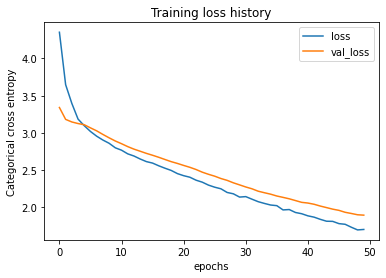

In [104]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

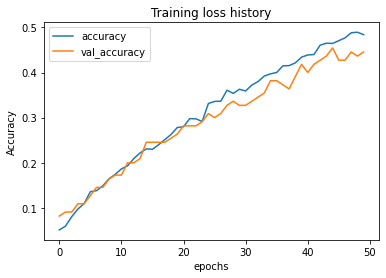

In [105]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [ ]:
L1_model.save('L1Model.h5')

#Add data augmentation which will create more images and help with accuracy.

L1 (Lasso Regression) with Data Augmentation and Dropout.

In [41]:
#add reguarlizer to reduce overfitting 
reg = L1(3e-5)

In [42]:
#augmenting data to help train the model 
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.5),
])

In [43]:
#making a learning rate schedule to decay the learning rate. 
#Not using in this model because it decreased the accuracy aggresively.
 
#lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#    initial_learning_rate=3e-5,
#    decay_steps=50,
#    decay_rate=0.2)

In [44]:
L1_model2 = Sequential()
# define 3x3 filter window sizes. Create 32 filters.
L1_model2.add(Conv2D(filters=32, kernel_size=(3, 3), strides = (2,2),
                     activation='relu', input_shape=(256, 256, 3),
                     kernel_regularizer = reg))

#rescale the images 
tf.keras.layers.Rescaling(1./255)

# max pool in 2x2 window
#using data augmentation 
L1_model2.add(BatchNormalization())
L1_model2.add(MaxPooling2D(pool_size=(4, 4)))
data_augmentation
L1_model2.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

L1_model2.add(BatchNormalization())
L1_model2.add(MaxPooling2D((2, 2)))
data_augmentation
L1_model2.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

L1_model2.add(BatchNormalization())
L1_model2.add(MaxPooling2D((2, 2)))
data_augmentation
L1_model2.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

# transition to dense fully-connected part of network
L1_model2.add(Flatten())
L1_model2.add(Dense(64, activation='relu'))

#adding dropout to help with overfitting
L1_model2.add(Dropout(0.6)) 
L1_model2.add(Dense(22, activation='softmax'))

In [47]:
opt = Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-05)
L1_model2.compile(optimizer=opt, loss='categorical_crossentropy',  metrics=['accuracy'])

In [48]:
history_cnn = L1_model2.fit(train_ds, epochs= 50, validation_data= validation_ds)

Epoch 1/50
134/134 [==============================] - 51s 347ms/step - loss: 3.2876 - accuracy: 0.0765 - val_loss: 2.9995 - val_accuracy: 0.1364
Epoch 2/50
134/134 [==============================] - 58s 405ms/step - loss: 2.9718 - accuracy: 0.1427 - val_loss: 2.8074 - val_accuracy: 0.2000
Epoch 3/50
134/134 [==============================] - 57s 400ms/step - loss: 2.7161 - accuracy: 0.2036 - val_loss: 2.5678 - val_accuracy: 0.2727
Epoch 4/50
134/134 [==============================] - 55s 382ms/step - loss: 2.4791 - accuracy: 0.2595 - val_loss: 2.3290 - val_accuracy: 0.3636
Epoch 5/50
134/134 [==============================] - 55s 388ms/step - loss: 2.2548 - accuracy: 0.3203 - val_loss: 2.1427 - val_accuracy: 0.3545
Epoch 6/50
134/134 [==============================] - 56s 392ms/step - loss: 2.1062 - accuracy: 0.3685 - val_loss: 2.0043 - val_accuracy: 0.4182
Epoch 7/50
134/134 [==============================] - 56s 394ms/step - loss: 1.9718 - accuracy: 0.3994 - val_loss: 1.8864 - val_ac

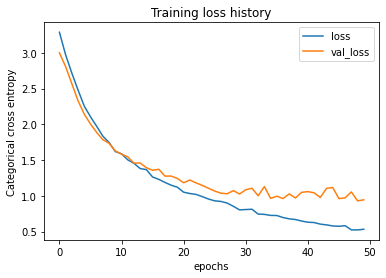

In [49]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

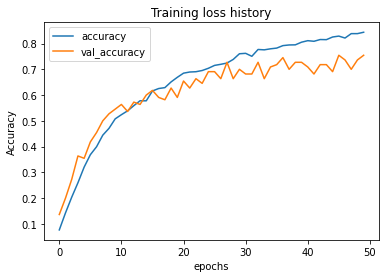

In [50]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [51]:
#sanity check, evaluate on the validation set
L1_model2.evaluate(validation_ds)

4/4 [==============================] - 1s 24ms/step - loss: 0.9444 - accuracy: 0.7545


[0.944437563419342, 0.7545454502105713]

In [52]:
#moment of truth
L1_model2.evaluate(test_ds)

4/4 [==============================] - 3s 23ms/step - loss: 0.9224 - accuracy: 0.7818


[0.9224209189414978, 0.7818182110786438]

In [53]:
L1_model2.save('L1AugmentationModel.h5')

In [55]:
valid_generator = ImageDataGenerator()
img_width, img_height = 256, 256
valid_data_generator = valid_generator.flow_from_directory(
     '/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/valid',
     target_size=(img_width, img_height),
    batch_size=32,
    shuffle=False)
valid_steps_per_epoch = np.math.ceil(valid_data_generator.samples / valid_data_generator.batch_size)

predictions = L1_model2.predict(valid_data_generator, steps=valid_steps_per_epoch)
# Get most likely class
predicted_classes = np.argmax(predictions, axis=1)

Found 110 images belonging to 22 classes.
4/4 [==============================] - 36s 8s/step


In [56]:
true_classes = valid_data_generator.classes
class_labels = list(valid_data_generator.class_indices.keys()) 

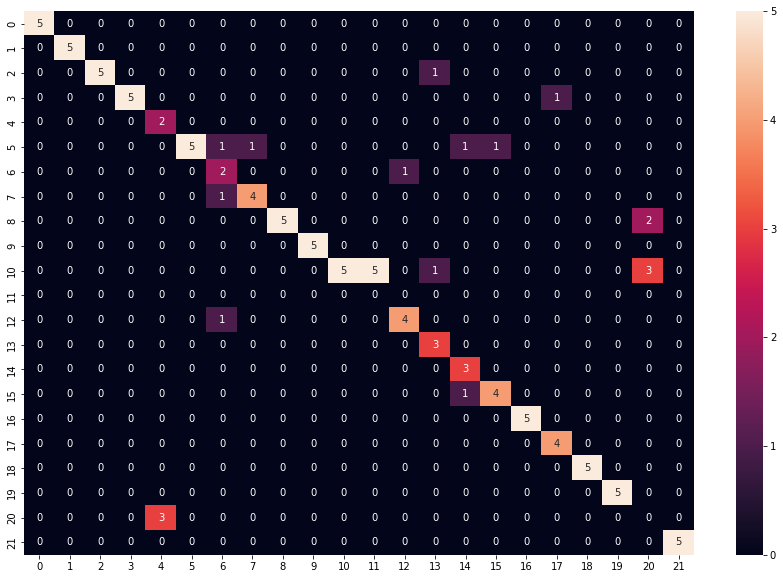

In [57]:
plt.figure(figsize=(15, 10))
ax= plt.subplot()
sns.heatmap(confusion_matrix(predicted_classes, true_classes), annot = True, fmt='g', ax=ax)

In [58]:
#metrics report
report = metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
print(report)

                                   precision    recall  f1-score   support

Alstonia Scholaris diseased (P2a)       1.00      1.00      1.00         5
 Alstonia Scholaris healthy (P2b)       1.00      1.00      1.00         5
             Arjun diseased (P1a)       0.83      1.00      0.91         5
              Arjun healthy (P1b)       0.83      1.00      0.91         5
              Bael diseased (P4b)       1.00      0.40      0.57         5
               Basil healthy (P8)       0.56      1.00      0.71         5
           Chinar diseased (P11b)       0.67      0.40      0.50         5
            Chinar healthy (P11a)       0.80      0.80      0.80         5
             Gauva diseased (P3b)       0.71      1.00      0.83         5
              Gauva healthy (P3a)       1.00      1.00      1.00         5
             Jamun diseased (P5b)       0.36      1.00      0.53         5
              Jamun healthy (P5a)       0.00      0.00      0.00         5
          Jatropha disea

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
L1_model2.save('BestL1Model.h5')

Look at the misclassified leaves

In [ ]:
plt.figure(figsize=(10, 10))
class_names = test_data.class_names
for images, labels in test_data.take(1):
    for i in range(32):
        ax = plt.subplot(6, 6, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

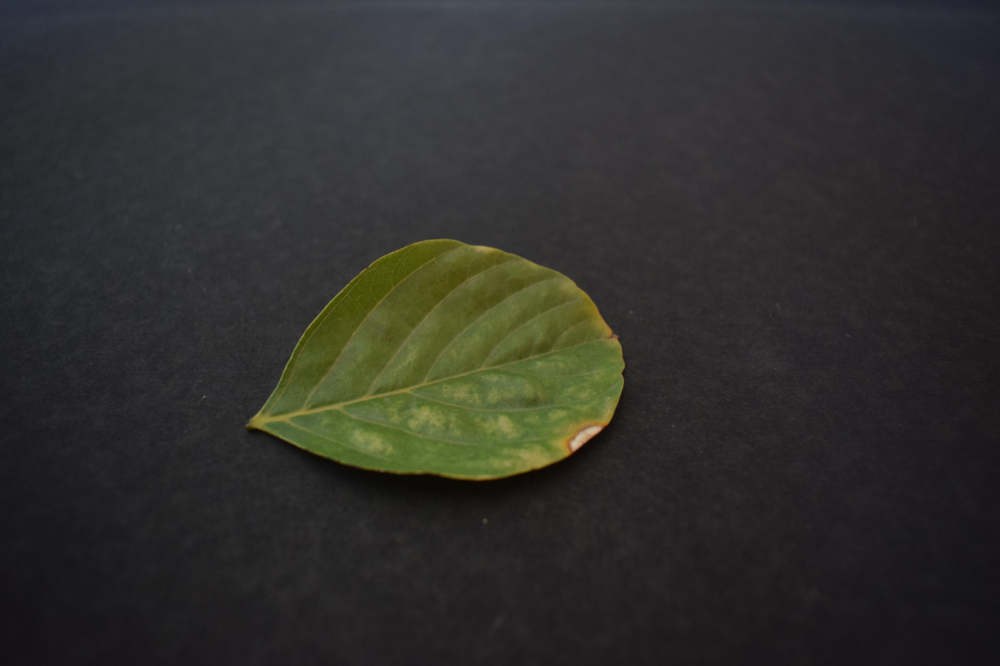

<Figure size 216x216 with 0 Axes>

In [15]:
path = '/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/train/Pongamia Pinnata diseased (P7b)/0019_0022.JPG'
Load_image = tf.keras.preprocessing.image.load_img(path)
Load_image

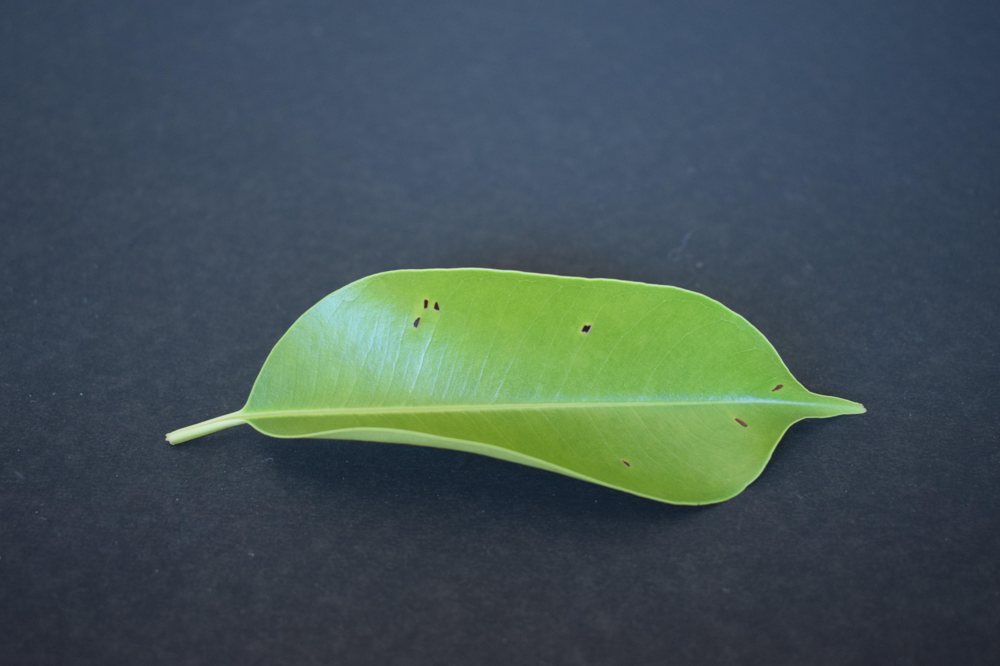

In [129]:
path = '/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/train/Jamun diseased (P5b)/0017_0021.JPG'
Load_image = tf.keras.preprocessing.image.load_img(path)
Load_image

#L2 (Ridge Regression) regularizer with Augmentation

In [23]:
#setup a regularizer 
reg = L2(3e-5)

In [24]:
#since I only have 4K data points for 22 classifications, using augments to create more data
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.5),
])

In [25]:
#making a learning rate schedule to decay the learning rate 
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=3e-5,
    decay_steps=50,
    decay_rate=0.9)

In [26]:
L2_model = Sequential()
# define 3x3 filter window sizes. Create 32 filters.
L2_model.add(Conv2D(filters=32,
                        kernel_size=(3, 3), strides = (2,2),
                        activation='relu',
                        input_shape=(256, 256, 3),
                        kernel_regularizer = reg))

#rescale the images 
tf.keras.layers.Rescaling(1./255)
# max pool in 2x2 window
L2_model.add(BatchNormalization())
L2_model.add(MaxPooling2D(pool_size=(4, 4)))
data_augmentation
L2_model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

L2_model.add(BatchNormalization())
L2_model.add(MaxPooling2D((2, 2)))
data_augmentation
L2_model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer = reg))

# transition to dense fully-connected part of network
L2_model.add(Flatten())
L2_model.add(Dense(64, activation='relu'))
L2_model.add(Dropout(0.3)) 
L2_model.add(Dense(22, activation='softmax'))

In [27]:
opt = Adam(learning_rate = lr_schedule, beta_1=0.9, beta_2=0.999, epsilon=1e-05)
L2_model.compile(optimizer=opt, loss='categorical_crossentropy',  metrics=['accuracy'])

In [28]:
history_cnn = L2_model.fit(train_ds, epochs= 50, validation_data= validation_ds)

Epoch 1/50
134/134 [==============================] - 56s 388ms/step - loss: 3.3272 - accuracy: 0.0814 - val_loss: 3.0075 - val_accuracy: 0.1000
Epoch 2/50
134/134 [==============================] - 52s 364ms/step - loss: 2.8361 - accuracy: 0.1614 - val_loss: 2.7986 - val_accuracy: 0.1545
Epoch 3/50
134/134 [==============================] - 47s 330ms/step - loss: 2.6191 - accuracy: 0.2211 - val_loss: 2.6171 - val_accuracy: 0.2182
Epoch 4/50
134/134 [==============================] - 56s 395ms/step - loss: 2.4710 - accuracy: 0.2632 - val_loss: 2.4971 - val_accuracy: 0.2727
Epoch 5/50
134/134 [==============================] - 60s 425ms/step - loss: 2.3356 - accuracy: 0.2993 - val_loss: 2.4308 - val_accuracy: 0.2818
Epoch 6/50
134/134 [==============================] - 62s 438ms/step - loss: 2.2648 - accuracy: 0.3278 - val_loss: 2.3761 - val_accuracy: 0.3000
Epoch 7/50
134/134 [==============================] - 61s 426ms/step - loss: 2.2105 - accuracy: 0.3498 - val_loss: 2.3315 - val_ac

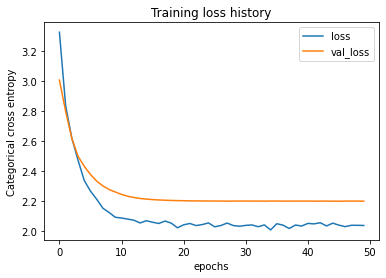

In [29]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

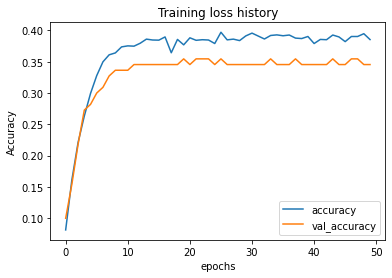

In [30]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [127]:
L2_model.save('L2Model.h5')

#Transfer learning 

In [7]:
from tensorflow.keras.applications import VGG16, VGG19

In [8]:
#remove the top layer 
base_vgg_model = VGG16(include_top=False, weights = 'imagenet')
for layers in base_vgg_model.layers:
  layers.trainable = False

58889256/58889256 [==============================] - 0s 0us/step


In [9]:
base_vgg_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

In [10]:
from tensorflow.keras import Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Resizing, RandomFlip, RandomRotation
from tensorflow.keras.layers import GlobalAveragePooling2D

In [11]:
# data augmenter and resize
data_augmentation_vgg = tf.keras.Sequential([
  Resizing(224, 224),
])

# specialized vgg16 preprocesser
vgg_processor = tf.keras.applications.vgg16.preprocess_input 

In [12]:
def my_little_model():
  input = Input(shape = (256,256, 3))
  x = data_augmentation_vgg(input)
  x = vgg_processor(x)
  x = base_vgg_model(x)
  # fnc = Flatten()(x)
  # x = Dense(64, activation = 'relu')(x)
  x = Conv2D(22, 1, padding = 'same', activation = 'relu')(x)
  x = GlobalAveragePooling2D()(x)
  output = Dense(22, activation = 'softmax')(x)

  my_first_vgg = Model(inputs = input, outputs = output)

  return my_first_vgg

In [13]:
my_mod = my_little_model()
my_mod.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 224, 224, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)      0         
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 conv2d (Conv2D)             (None, 7, 7, 22)          11286     
                                                             

In [14]:
my_mod.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [15]:
history_cnn = my_mod.fit(train_ds, validation_data = validation_ds, epochs=30)

Epoch 1/30
134/134 [==============================] - 195s 1s/step - loss: 2.3750 - accuracy: 0.3603 - val_loss: 1.7649 - val_accuracy: 0.4455
Epoch 2/30
134/134 [==============================] - 172s 1s/step - loss: 0.8589 - accuracy: 0.7656 - val_loss: 1.0999 - val_accuracy: 0.6364
Epoch 3/30
134/134 [==============================] - 173s 1s/step - loss: 0.5171 - accuracy: 0.8521 - val_loss: 0.8589 - val_accuracy: 0.6909
Epoch 4/30
134/134 [==============================] - 174s 1s/step - loss: 0.3875 - accuracy: 0.8863 - val_loss: 0.7459 - val_accuracy: 0.7000
Epoch 5/30
134/134 [==============================] - 174s 1s/step - loss: 0.3105 - accuracy: 0.9116 - val_loss: 0.6688 - val_accuracy: 0.7364
Epoch 6/30
134/134 [==============================] - 174s 1s/step - loss: 0.2596 - accuracy: 0.9249 - val_loss: 0.7083 - val_accuracy: 0.7273
Epoch 7/30
134/134 [==============================] - 173s 1s/step - loss: 0.2267 - accuracy: 0.9350 - val_loss: 0.6186 - val_accuracy: 0.7818

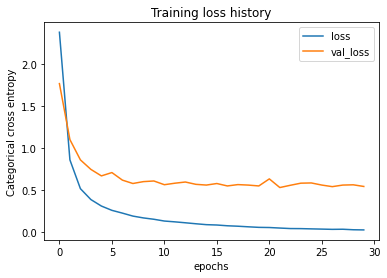

In [16]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

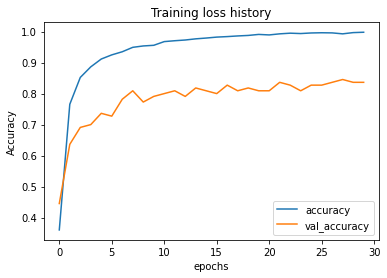

In [17]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [19]:
valid_generator = ImageDataGenerator()
img_width, img_height = 256, 256
valid_data_generator = valid_generator.flow_from_directory(
     '/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/valid',
     target_size=(img_width, img_height),
    batch_size=32,
    shuffle=False)
valid_steps_per_epoch = np.math.ceil(valid_data_generator.samples / valid_data_generator.batch_size)

predictions = my_mod.predict(valid_data_generator, steps=valid_steps_per_epoch)
# Get most likely class
predicted_classes = np.argmax(predictions, axis=1)

Found 110 images belonging to 22 classes.
4/4 [==============================] - 37s 9s/step


In [20]:
true_classes = valid_data_generator.classes
class_labels = list(valid_data_generator.class_indices.keys()) 

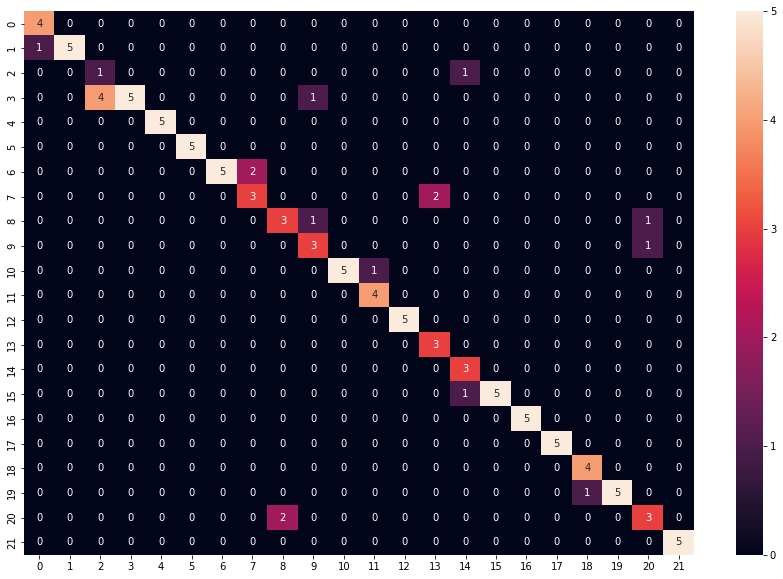

In [21]:
plt.figure(figsize=(15, 10))
ax= plt.subplot()
sns.heatmap(confusion_matrix(predicted_classes, true_classes), annot = True, fmt='g', ax=ax)

In [22]:
#metrics report
report = metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
print(report)

                                   precision    recall  f1-score   support

Alstonia Scholaris diseased (P2a)       1.00      0.80      0.89         5
 Alstonia Scholaris healthy (P2b)       0.83      1.00      0.91         5
             Arjun diseased (P1a)       0.50      0.20      0.29         5
              Arjun healthy (P1b)       0.50      1.00      0.67         5
              Bael diseased (P4b)       1.00      1.00      1.00         5
               Basil healthy (P8)       1.00      1.00      1.00         5
           Chinar diseased (P11b)       0.71      1.00      0.83         5
            Chinar healthy (P11a)       0.60      0.60      0.60         5
             Gauva diseased (P3b)       0.60      0.60      0.60         5
              Gauva healthy (P3a)       0.75      0.60      0.67         5
             Jamun diseased (P5b)       0.83      1.00      0.91         5
              Jamun healthy (P5a)       1.00      0.80      0.89         5
          Jatropha disea

In [70]:
my_mod.save('Transfer_Model.h5')

Fine Tuning

In [23]:
my_mod.layers[4].layers[-2].trainable = True
[layer.trainable for layer in my_mod.layers[4].layers]

In [25]:
my_mod.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [26]:
history_cnn = my_mod.fit(train_ds, validation_data = validation_ds, epochs=15)

Epoch 1/15
134/134 [==============================] - 180s 1s/step - loss: 1.7453 - accuracy: 0.8084 - val_loss: 0.7803 - val_accuracy: 0.7818
Epoch 2/15
134/134 [==============================] - 178s 1s/step - loss: 0.1722 - accuracy: 0.9436 - val_loss: 0.7339 - val_accuracy: 0.8273
Epoch 3/15
134/134 [==============================] - 179s 1s/step - loss: 0.1040 - accuracy: 0.9640 - val_loss: 0.9793 - val_accuracy: 0.7545
Epoch 4/15
134/134 [==============================] - 179s 1s/step - loss: 0.0522 - accuracy: 0.9829 - val_loss: 0.8859 - val_accuracy: 0.8091
Epoch 5/15
134/134 [==============================] - 180s 1s/step - loss: 0.0858 - accuracy: 0.9726 - val_loss: 0.7998 - val_accuracy: 0.7636
Epoch 6/15
134/134 [==============================] - 180s 1s/step - loss: 0.0528 - accuracy: 0.9818 - val_loss: 0.9392 - val_accuracy: 0.7727
Epoch 7/15
134/134 [==============================] - 180s 1s/step - loss: 0.0474 - accuracy: 0.9850 - val_loss: 0.8093 - val_accuracy: 0.8182

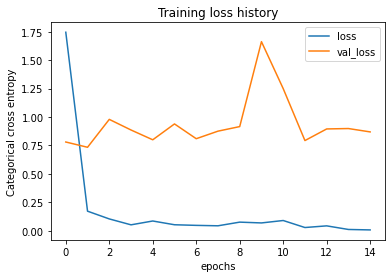

In [27]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

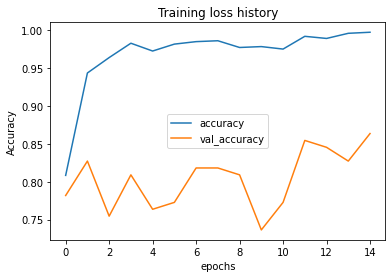

In [28]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

In [34]:
valid_generator = ImageDataGenerator()
img_width, img_height = 256, 256
valid_data_generator = valid_generator.flow_from_directory(
     '/content/drive/MyDrive/Colab Notebooks/Plant_Leaf_Classitication/Data/Plants_2/valid',
     target_size=(img_width, img_height),
    batch_size=32,
    shuffle=False)
valid_steps_per_epoch = np.math.ceil(valid_data_generator.samples / valid_data_generator.batch_size)

predictions = my_mod.predict(valid_data_generator, steps=valid_steps_per_epoch)
# Get most likely class
predicted_classes = np.argmax(predictions, axis=1)

Found 110 images belonging to 22 classes.
4/4 [==============================] - 36s 8s/step


In [35]:
true_classes = valid_data_generator.classes
class_labels = list(valid_data_generator.class_indices.keys()) 

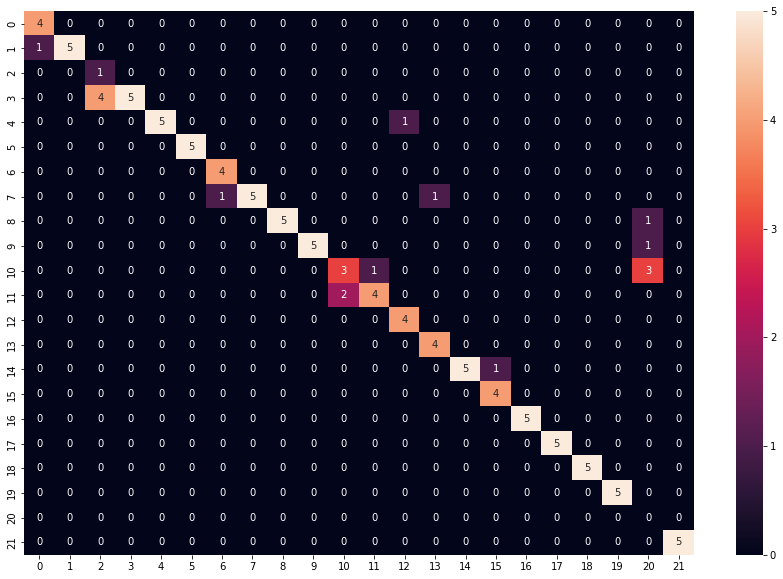

In [36]:
plt.figure(figsize=(15, 10))
ax= plt.subplot()
sns.heatmap(confusion_matrix(predicted_classes, true_classes), annot = True, fmt='g', ax=ax)

In [37]:
#metrics report
report = metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
print(report)

                                   precision    recall  f1-score   support

Alstonia Scholaris diseased (P2a)       1.00      0.80      0.89         5
 Alstonia Scholaris healthy (P2b)       0.83      1.00      0.91         5
             Arjun diseased (P1a)       1.00      0.20      0.33         5
              Arjun healthy (P1b)       0.56      1.00      0.71         5
              Bael diseased (P4b)       0.83      1.00      0.91         5
               Basil healthy (P8)       1.00      1.00      1.00         5
           Chinar diseased (P11b)       1.00      0.80      0.89         5
            Chinar healthy (P11a)       0.71      1.00      0.83         5
             Gauva diseased (P3b)       0.83      1.00      0.91         5
              Gauva healthy (P3a)       0.83      1.00      0.91         5
             Jamun diseased (P5b)       0.43      0.60      0.50         5
              Jamun healthy (P5a)       0.67      0.80      0.73         5
          Jatropha disea

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#Add flip and rotation to transfer model

In [ ]:
def my_middle_model():
  input = Input(shape = (256,256, 3))
  x = data_augmentation_vgg(input)
  x = vgg_processor(x)
  x = base_vgg_model(x)
  # fnc = Flatten()(x)
  # x = Dense(64, activation = 'relu')(x)
  x = Conv2D(22, 1, padding = 'same', activation = 'relu')(x)
  x = GlobalAveragePooling2D()(x)
  output = Dense(22, activation = 'softmax')(x)

  my_first_vgg = Model(inputs = input, outputs = output)

  return my_first_vgg

In [31]:
#remove the top layer 
base_vgg_model = VGG16(include_top=False, weights = 'imagenet')
for layers in base_vgg_model.layers:
  layers.trainable = False

In [32]:
# data augmenter and resize
data_augmentation_vgg = tf.keras.Sequential([
  Resizing(224, 224),
  RandomFlip("horizontal_and_vertical"),
  RandomRotation(0.5),
])

# specialized vgg16 preprocesser
vgg_processor = tf.keras.applications.vgg16.preprocess_input 

In [ ]:
my_mod2.layers[4].layers[-2].trainable = True
[layer.trainable for layer in my_mod.layers[4].layers]

In [33]:
#2nd transfer model with data augamentor added 
data_augmentation
my_mod2 = my_little_model()
my_mod2.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 sequential_2 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem_1   (None, 224, 224, 3)      0         
 (SlicingOpLambda)                                               
                                                                 
 tf.nn.bias_add_1 (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 7, 22)          1128

In [143]:
my_mod2.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [144]:
history_cnn  = my_mod2.fit(train_ds, validation_data = validation_ds, epochs=20)

Epoch 1/20


134/134 [==============================] - 194s 1s/step - loss: 2.7275 - accuracy: 0.2351 - val_loss: 2.1090 - val_accuracy: 0.3818
Epoch 2/20
134/134 [==============================] - 189s 1s/step - loss: 1.3561 - accuracy: 0.6259 - val_loss: 1.1056 - val_accuracy: 0.6000
Epoch 3/20
134/134 [==============================] - 191s 1s/step - loss: 0.7987 - accuracy: 0.7775 - val_loss: 0.8587 - val_accuracy: 0.6727
Epoch 4/20
 89/134 [==================>...........] - ETA: 1:02 - loss: 0.6234 - accuracy: 0.8132

KeyboardInterrupt: ignored

In [ ]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

In [ ]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()

#adding regularizing to transfer model

In [38]:
#add reguarlizer to reduce overfitting 
reg = L1(3e-5)

In [39]:
def my_middle_model():
  input = Input(shape = (256,256, 3))
  x = data_augmentation_vgg(input)
  x = vgg_processor(x)
  x = base_vgg_model(x)
  # fnc = Flatten()(x)
  # x = Dense(64, activation = 'relu')(x)
  x = Conv2D(22, 1, padding = 'same', activation = 'relu',kernel_regularizer = reg)(x)
  x = GlobalAveragePooling2D()(x)
  output = Dense(22, activation = 'softmax')(x)

  my_first_vgg = Model(inputs = input, outputs = output)

  return my_second_vgg

In [40]:
my_middle_model.layers[4].layers[-2].trainable = True
[layer.trainable for layer in my_mod.layers[4].layers]

AttributeError: ignored

In [ ]:
#2nd transfer model with data augamentor added 
my_mod3 = my_middle_model()
my_mod3.summary()

In [ ]:
my_mod3.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [ ]:
history_cnn = my_mod3.fit(train_ds, validation_data = validation_ds, epochs=15)

In [ ]:
train_cnn_history = pd.DataFrame(history_cnn.history)
train_cnn_history.index.name = 'epochs'

col_list = ['loss', 'val_loss']
train_cnn_history[col_list].plot()
plt.ylabel('Categorical cross entropy')
plt.title('Training loss history')
plt.show()

In [ ]:
col_list = ['accuracy', 'val_accuracy']
train_cnn_history[col_list].plot()
plt.ylabel('Accuracy')
plt.title('Training loss history')
plt.show()